In [3]:
import pandas as pd
import sys

sys.path.append('../gtm/')
from corpus import GTMCorpus
from gtm_customized import GTM
import pickle as p

import os

language = 'en-zh'

In [4]:
def load_examples(language='en'):
  df = pd.read_csv('../data/wiki_shorts/{}/corpus/docs.txt'.format(language), header=None, delimiter='\t')
  df.columns = ['doc_clean']
  # df = df.head(1000)
  return df

In [5]:
if not os.path.exists('train_dataset_intfloat-e5-large2-{}.pkl'.format(language)):
  # if True:
  df_en = load_examples('en')
  df_zh = load_examples('zh')

  # merge two dfs into one df, with additional column specifying the language
  df_en['language'] = 'en'
  df_zh['language'] = 'zh'

  # randomly select 100 documents from each language
  # df_en = df_en.sample(n=100)
  # df_zh = df_zh.sample(n=100)

  # Concatenate the two DataFrames
  df = pd.concat([df_en, df_zh], ignore_index=True)

  train_dataset = GTMCorpus(
    df,
    count_words=True,
    embeddings_type='SentenceTransformer',
    sbert_model_to_load='intfloat/multilingual-e5-large',
    content=None,
    batch_size=64,
    max_seq_length=512)
  print('Saving train_dataset_intfloat-e5-large2-{}.pkl'.format(language))
  with open('train_dataset_intfloat-e5-large2-{}.pkl'.format(language), 'wb') as f:
    p.dump(train_dataset, f)
else:
  print('Loading train_dataset_intfloat-e5-large2-{}.pkl'.format(language))
  with open('train_dataset_intfloat-e5-large2-{}.pkl'.format(language), 'rb') as f:
    train_dataset = p.load(f)

print('dataset loaded')

Loading train_dataset_intfloat-e5-large2-en-zh.pkl
dataset loaded


In [8]:
# Train the model
tm = GTM(
	train_dataset,
	n_topics=6,
	doc_topic_prior='dirichlet', # logistic_normal, dirichlet
	alpha=0.02,
	update_prior=False,
	encoder_input='bow', # 'bow', 'embeddings'
  separate_encoders=True,
  separate_decoders=True,
	encoder_hidden_layers=[512, 256], # structure of the encoder neural net
	decoder_hidden_layers=[256], # structure of the decoder neural net
	encoder_bias=True,
	decoder_bias=True,
	num_epochs=0,
	print_every=10000,
	dropout=0.0,
	learning_rate=0.01,
	log_every=1,
	w_prior=None,
	batch_size=512,
	patience=5,
	save_path='../ckpt2/task4',
	ckpt='../ckpt2/task4/best_model.ckpt',
)

Loading checkpoint from ../ckpt2/task4/best_model.ckpt
OrderedDict([('encoder.enc_0.weight', tensor([[-0.0007, -0.0009, -0.0012,  ..., -0.0011,  0.0017,  0.0018],
        [-0.0016, -0.0004,  0.0009,  ..., -0.0018,  0.0010, -0.0004],
        [ 0.0011,  0.0002, -0.0008,  ..., -0.0019, -0.0016, -0.0015],
        ...,
        [-0.0015,  0.0008, -0.0017,  ...,  0.0012,  0.0005, -0.0003],
        [-0.0008,  0.0001,  0.0016,  ..., -0.0020,  0.0016, -0.0003],
        [-0.0011, -0.0011, -0.0011,  ...,  0.0019,  0.0010, -0.0019]],
       device='mps:0')), ('encoder.enc_0.bias', tensor([-0.0585, -0.1997, -0.0581, -0.2972, -0.0603, -0.0608, -0.0607, -0.1153,
        -0.0600, -0.0601, -0.2411, -0.0585,  0.6973, -0.0582, -0.0616, -0.2789,
         0.1704, -0.0583, -0.3391, -0.2090, -0.0767, -0.0582, -0.0604, -0.1658,
        -0.1915, -0.3291, -0.3032, -0.0585, -0.0601, -0.2603, -0.0594, -0.0584,
        -0.0596, -0.3398, -0.3048, -0.3567, -0.0598, -0.0600, -0.0602, -0.2975,
        -0.0593, -0.0586,

In [9]:
import numpy as np

def inspect(tm, ds):
  doc_topic_distribution = tm.get_doc_topic_distribution(ds)

  print('Number of documents per topic')
  print('Topic 0: {}'.format((doc_topic_distribution.argmax(-1) == 0).sum()))
  print('Topic 1: {}'.format((doc_topic_distribution.argmax(-1) == 1).sum()))
  print('Topic 2: {}'.format((doc_topic_distribution.argmax(-1) == 2).sum()))
  print('Topic 3: {}'.format((doc_topic_distribution.argmax(-1) == 3).sum()))
  print('Topic 4: {}'.format((doc_topic_distribution.argmax(-1) == 4).sum()))
  print('Topic 5: {}'.format((doc_topic_distribution.argmax(-1) == 5).sum()))

  # show five random documents per topic
  for topic in range(tm.n_topics):
    print('Topic {}'.format(topic))
    print('xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx')
    for i in np.random.choice(np.where(doc_topic_distribution.argmax(-1) == topic)[0], 5):
      print('=' * 50)
      print(ds.df.iloc[i]['doc_clean'])
      print('----------')
      print('Topic distribution = {}'.format(doc_topic_distribution[i]))

In [10]:
inspect(tm, train_dataset)

Number of documents per topic
Topic 0: 3594
Topic 1: 3187
Topic 2: 3021
Topic 3: 4536
Topic 4: 3307
Topic 5: 3533
Topic 0
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
牛排 饭 是 一 种 食品 是 以 牛排 作为 主菜 搭配 其他 配菜 的 一 种 饭 类 料理 。 在 台湾 牛排 饭 常见于 中餐 与 晚餐 便当 中的 一 个 品项 作为 主菜 的 牛排 以 煎 、 烤 为主 。 有些 西餐厅 也 会 提供 牛排 饭 但 大多 酌以 特殊 的 调味 如 黑胡椒 、 迷迭香 等 。
----------
Topic distribution = [0.4792452  0.11675616 0.11157046 0.04432032 0.18110609 0.06700177]
越橘 学名 Vacciniumvitisidaea 又 名 温普盛 京 通志 、 红豆 黑龙江 、 牙 疙瘩 大兴安岭 是 杜鹃花科 的 落叶 灌木 植物 有 北国 红豆 赞誉 性 耐寒 味 熟 时 略 酸 甜 未 熟 略 苦 生长 在 海拔 米 针叶林 与 阔叶树 交混区 红 果实 可当 果酱 、 鲜食 叶可 制成 茶叶 泡 茶叶 含 乌苏 酸 、 鞣质 成分 。 中医学 认为 它 利尿 消炎 。 喜 酸性 潮湿 土壤 。 含有 丰富 的 维他命A 、 维他命C 、 B 族 维他命 等 营养 量 野生 欧洲 越橘 大量 分布 在 斯堪 的 纳维亚 半岛 挪威 和 瑞典 。 特征 外部 链接 简体 中文 中国 数字 植物 标本馆 中 的 相关 内容 越橘
----------
Topic distribution = [1.0000000e+00 8.4053192e-29 8.8834118e-36 1.7652152e-28 7.4183540e-27
 0.0000000e+00]
马祖 列岛 燕鸥 保护区 位 于 马祖 列岛 中 的 八 座 无 人 岛礁 ， 包括 各 岛礁 低潮 线 向 海域 延伸 一百 公尺 的 范围 ， 为 依据 《 野生 动物 保育法 》 公告 之 野生 

In [11]:
# write a function to write all examples of the same topic to a file
def write_topic_to_file(topic_id, ds, doc_topic_distribution, path):
  with open(path, 'w') as f:
    for i in np.where(doc_topic_distribution.argmax(-1) == topic_id)[0]:
      f.write(ds.df.iloc[i]['doc_clean'] + '\n')

In [12]:
doc_topic_distribution = tm.get_doc_topic_distribution(train_dataset)
import os

if not os.path.exists('../data/task4'):
  os.makedirs('../data/task4')

In [13]:
write_topic_to_file(0, train_dataset, doc_topic_distribution, '../data/task4/topic_0.txt')
write_topic_to_file(1, train_dataset, doc_topic_distribution, '../data/task4/topic_1.txt')
write_topic_to_file(2, train_dataset, doc_topic_distribution, '../data/task4/topic_2.txt')
write_topic_to_file(3, train_dataset, doc_topic_distribution, '../data/task4/topic_3.txt')
write_topic_to_file(4, train_dataset, doc_topic_distribution, '../data/task4/topic_4.txt')
write_topic_to_file(5, train_dataset, doc_topic_distribution, '../data/task4/topic_5.txt')

In [14]:
# read labels
def read_labels(language='en'):
  with open('../data/wiki_shorts/{}/corpus/docs.txt'.format(language), 'r') as file:
    docs = file.readlines()
  with open('../data/wiki_shorts/{}/labels.txt'.format(language), 'r') as file:
    labels = file.readlines()

  # one to one mapping of docs to labels
  doc2label = {}
  for i in range(len(docs)):
    doc2label[docs[i][:100].strip()] = int(labels[i].strip())
  return doc2label

In [15]:
doc2label_en = read_labels('en')
doc2label_zh = read_labels('zh')

In [16]:
# for each topic, find its majority label
from collections import defaultdict

def find_majority_label(topic):
  label2cnt = defaultdict(int)
  labels = []
  with open('../data/task4/topic_{}.txt'.format(topic), 'r') as file:
    lines = file.readlines()
    for line in lines:
      k = line[:100].strip()
      if k in doc2label_en:
        v = doc2label_en[k]
      else:
        v = doc2label_zh[k]
      label2cnt[v] += 1
      labels.append(v)
  predicted = max(label2cnt, key=lambda k: label2cnt[k])
  return label2cnt, labels, predicted

In [17]:
_, labels_0, predicted_0 = find_majority_label(0)
_, labels_1, predicted_1 = find_majority_label(1)
_, labels_2, predicted_2 = find_majority_label(2)
_, labels_3, predicted_3 = find_majority_label(3)
_, labels_4, predicted_4 = find_majority_label(4)
_, labels_5, predicted_5 = find_majority_label(5)

In [18]:
print(predicted_0, predicted_1, predicted_2, predicted_3, predicted_4, predicted_5)

2 3 4 1 1 0


In [19]:
final_labels = labels_0 + labels_1 + labels_2 + labels_3 + labels_4 + labels_5

In [20]:
len(final_labels)

21178

In [21]:
final_pred = [predicted_0] * len(labels_0) + [predicted_1] * len(labels_1) + [predicted_2] * len(labels_2) + [
  predicted_3] * len(labels_3) + [predicted_4] * len(labels_4) + [predicted_5] * len(labels_5)

In [22]:
len(final_pred)

21178

In [23]:
model_pred = [0]*len(labels_0) + [1]*len(labels_1) + [2]*len(labels_2) + [3]*len(labels_3) + [4]*len(labels_4) + [5]*len(labels_5)

In [24]:
from sklearn.metrics import f1_score, accuracy_score, adjusted_rand_score

f1_macro = f1_score(y_true=final_labels, y_pred=final_pred, average='macro')
f1_micro = f1_score(y_true=final_labels, y_pred=final_pred, average='micro')
acc = accuracy_score(y_true=final_labels, y_pred=final_pred)
ars = adjusted_rand_score(labels_true=final_labels, labels_pred=model_pred)

In [25]:
print('f1_macro = {}'.format(f1_macro))
print('f1_micro = {}'.format(f1_micro))
print('acc = {}'.format(acc))
print('ars = {}'.format(ars))

f1_macro = 0.3090372770612513
f1_micro = 0.36259325715365004
acc = 0.36259325715365004
ars = 0.1146880091759331


In [26]:
wordcloud_args = {'background_color': 'white',
                  'font_path': '/System/Library/Fonts/Supplemental/Songti.ttc',
                  'min_font_size': 10,
                  'max_font_size': 100,
                  'max_words': 2000,
                  'height': 1000,
                  'width': 2000}

{'台湾': 0.010068652220070362, '中国': 0.006215824745595455, '日本': 0.004532200284302235, '香港': 0.004166400525718927, '美国': 0.0033467544708400965, '主要': 0.003162570996209979, '大学': 0.0030277997720986605, '学名': 0.0030191796831786633, '电影': 0.0026715819258242846, '地区': 0.002383341547101736, '牠们': 0.002333490876480937, '国家': 0.0021769970189779997, '由于': 0.002102786209434271, '英语': 0.0020463294349610806, '认为': 0.001982823945581913, '世界': 0.00196232576854527, '其他': 0.0019272075733169913, '中华': 0.0019218830857425928, '第一': 0.0019172350876033306, '发现': 0.0018903457093983889, '制作': 0.0018265803810209036, '成为': 0.0018139461753889918, '开始': 0.0017879256047308445, '因此': 0.0017879025544971228, '以及': 0.001707560266368091, '可以': 0.0017049933085218072, '动物': 0.0016748221823945642, '分布': 0.0016289582708850503, '物种': 0.0016093463636934757, '大陆': 0.0016013776184991002, '一般': 0.0015867229085415602, '不同': 0.0015543539775535464, '之一': 0.0015186870004981756, '包括': 0.001500643091276288, '使用': 0.001496291719377040

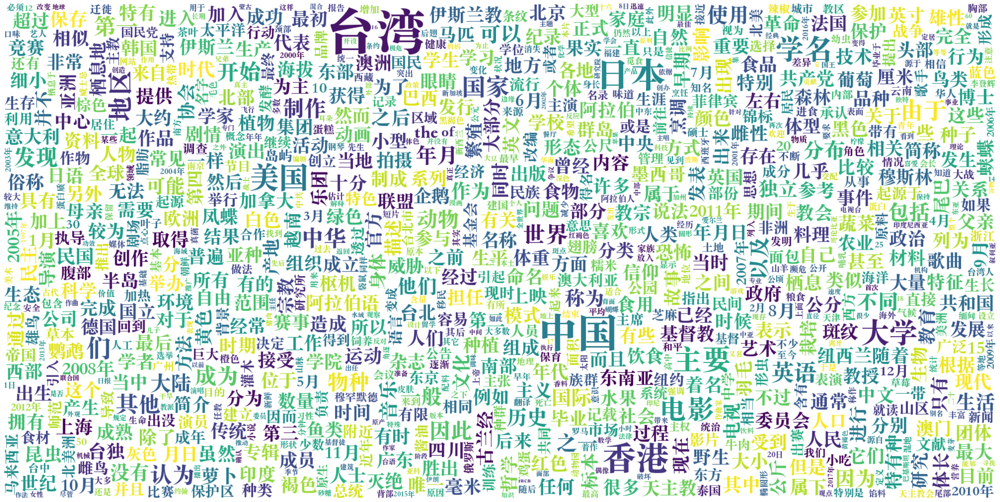

In [27]:
tm.plot_wordcloud(topic_id=0, topK=1000, output_path='../data/task4/topic_0.jpg', wordcloud_args=wordcloud_args, figsize=(40, 80))

{'大学': 0.006891648285090923, '中国': 0.005543518345803022, '台湾': 0.004987227730453014, '美国': 0.004778353497385979, '年月': 0.004434497095644474, '运动': 0.003665221156552434, '国家': 0.003646102035418153, '政府': 0.0031931286212056875, '成为': 0.0031185189727693796, '主义': 0.0030775738414376974, '学校': 0.0027770637534558773, '中华': 0.002687233965843916, '认为': 0.0025685294531285763, '组织': 0.0025683410931378603, '他们': 0.0025533298030495644, '电影': 0.0023866828996688128, '第一': 0.002366338623687625, '开始': 0.0023648596834391356, '日本': 0.002349668415263295, '革命': 0.0023234228137880564, '世界': 0.0022786674089729786, '政治': 0.0022519181948155165, '英语': 0.002171784872189164, '伊斯兰': 0.0019309228518977761, '成立': 0.0019072889117524028, '宗教': 0.001879134331829846, '人民': 0.0018737291684374213, '自己': 0.0018543869955465198, '教会': 0.0017820263747125864, '香港': 0.0017772394930943847, '历史': 0.0017474447377026081, '学院': 0.0017395383911207318, '社会': 0.0017387248808518052, '民国': 0.0017100218683481216, '独立': 0.0016774876276031

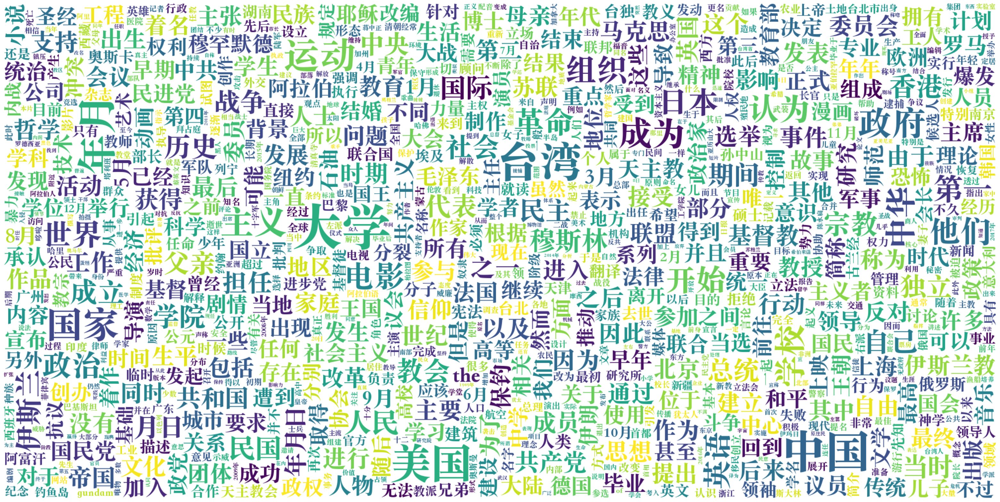

In [28]:
tm.plot_wordcloud(topic_id=1, topK=1000, output_path='../data/task4/topic_1.jpg', wordcloud_args=wordcloud_args, figsize=(40, 80))

{'分布': 0.07482283562421799, '学名': 0.05331875756382942, '蛱蝶': 0.02676166594028473, '物种': 0.025658683851361275, '产地': 0.02168668992817402, '海拔': 0.021570807322859764, '中南': 0.01461226586252451, '模式': 0.012582297436892986, '本岛': 0.012435768730938435, '灰蝶': 0.011438560672104359, '喜马拉雅': 0.011160583235323429, '俗名': 0.010516773909330368, '属下': 0.010474962182343006, '中低': 0.009876438416540623, '地区': 0.009747902862727642, '半岛': 0.008909949101507664, '栖息于': 0.007922247983515263, '华西': 0.007651107851415873, '辐鳍': 0.007053951267153025, '鲤形目': 0.006958030629903078, '粉蝶': 0.006598158739507198, '云南': 0.006588554009795189, '鲤科': 0.006535530090332031, '凤蝶': 0.006248447112739086, '四川': 0.006092838477343321, '印度': 0.005728287156671286, '福建': 0.005246127489954233, '蝴蝶': 0.004731392953544855, '水系': 0.004704210441559553, '等地': 0.004536708351224661, '中国': 0.004394772462546825, '甘肃': 0.004185320343822241, '又名': 0.0037966016680002213, '分佈': 0.003761760890483856, '鸟类': 0.003676731837913394, '乌苏里江': 0.003403665

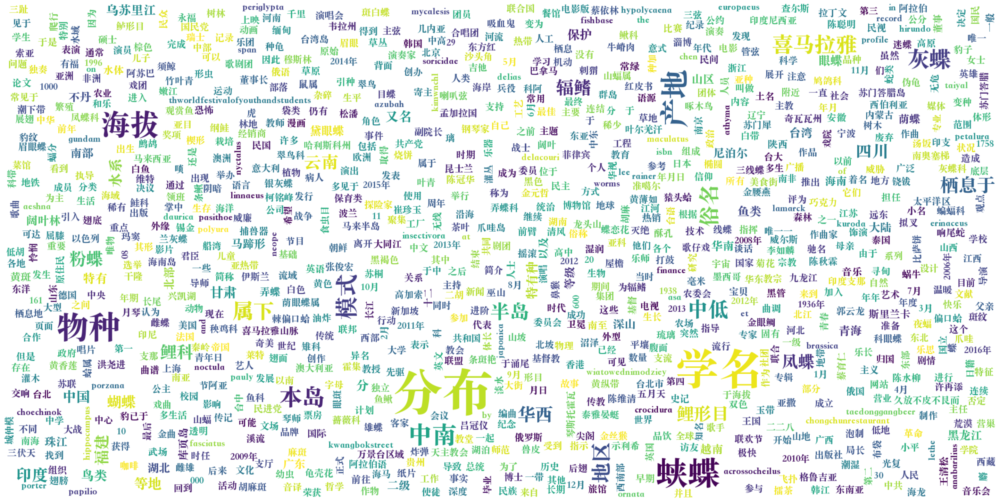

In [29]:
tm.plot_wordcloud(topic_id=2, topK=1000, output_path='../data/task4/topic_2.jpg', wordcloud_args=wordcloud_args, figsize=(40, 80))

{'鲮鱼': 0.032237209379673004, '灰黑色': 0.013333544135093689, '前年': 0.011431421153247356, '中东': 0.008992284536361694, '后缘': 0.007397923618555069, '种龟': 0.0067390152253210545, '草龟': 0.005629830993711948, 'caglei': 0.0053087580017745495, '学名': 0.00514127966016531, 'cagle': 0.005110136698931456, '哈斯': 0.00487342057749629, '君主': 0.004785810597240925, '又名': 0.004455236252397299, '灰蝶': 0.004446030594408512, '早期': 0.004339518956840038, '希伯来语': 0.004100182093679905, '在位': 0.003941843286156654, '属下': 0.003888386068865657, '古代': 0.00356042361818254, '全蹼': 0.003479236736893654, '按蚊': 0.0033043164294213057, '卡氏': 0.003250343259423971, '登年': 0.003147341078147292, '目前': 0.0030019250698387623, '加辖': 0.0029612372163683176, '金线龟': 0.0028572161681950092, '雌雄性': 0.0028338429983705282, '球粥': 0.002785908058285713, 'jehoahaz': 0.00269460235722363, '斑纹': 0.0026907247956842184, '卡格尔': 0.0026736941654235125, 'jeroboamii': 0.0026700147427618504, 'joram': 0.002644576597958803, '啄木鸟': 0.0026289457455277443, 'anophele

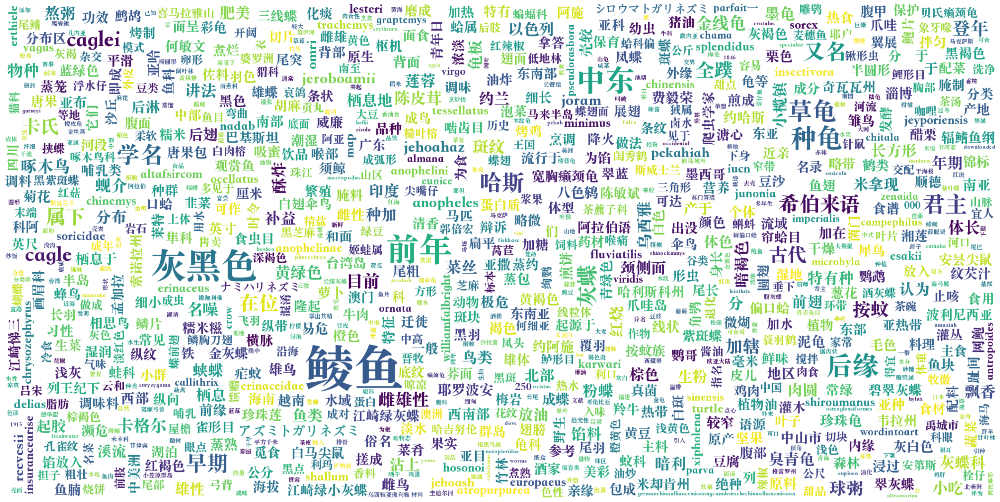

In [30]:
tm.plot_wordcloud(topic_id=3, topK=1000, output_path='../data/task4/topic_3.jpg', wordcloud_args=wordcloud_args, figsize=(40, 80))

{'台湾': 0.007631237618625164, '电影': 0.005716563202440739, '音乐': 0.005496372003108263, '专辑': 0.004388488829135895, '自己': 0.003548859851434827, '中国': 0.0034400697331875563, '开始': 0.003428457770496607, '美国': 0.0032594348303973675, '发行': 0.0030410641338676214, '第一': 0.003025906393304467, '唱片': 0.002908827271312475, '乐团': 0.002754019573330879, '公司': 0.002714084228500724, '他们': 0.002711877226829529, '担任': 0.002682503778487444, '获得': 0.002672879258170724, '歌手': 0.0024458447005599737, '成为': 0.0024173695128411055, '发现': 0.0023940359242260456, '参加': 0.0023752967827022076, '大学': 0.002335379831492901, '日本': 0.0022830122616142035, '节目': 0.0021621237974613905, '歌曲': 0.0021179895848035812, '创作': 0.0020180847495794296, '上映': 0.002012354787439108, '演出': 0.001932464074343443, '之后': 0.0018744664266705513, '英语': 0.001834925264120102, '制作': 0.0018072905950248241, '世界': 0.0017700709868222475, '父亲': 0.0016235170187428594, '台北': 0.0016012745909392834, '演唱': 0.0015959774609655142, '工作': 0.0015922384336590767, '

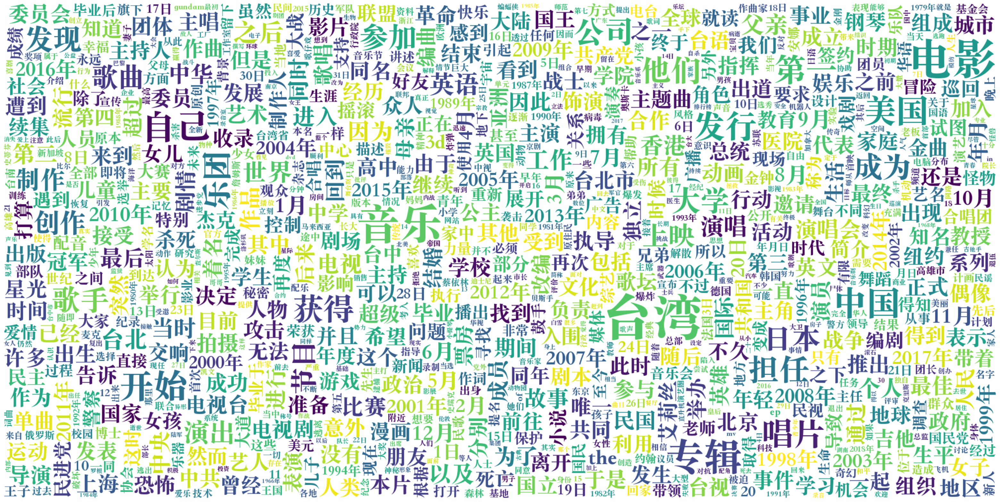

In [31]:
tm.plot_wordcloud(topic_id=4, topK=1000, output_path='../data/task4/topic_4.jpg', wordcloud_args=wordcloud_args, figsize=(40, 80))

{'歌仔戏': 0.011418428272008896, '音乐': 0.004915624391287565, '台湾': 0.0043496121652424335, '主弦': 0.003925336990505457, '乐团': 0.0037974549923092127, '指导': 0.0037451526150107384, '王清松': 0.0035948853474110365, '唱片': 0.003130227793008089, '专辑': 0.0028352446388453245, '文场': 0.002780117094516754, '喇叭弦': 0.00245782732963562, '领班': 0.0023209627252072096, '戏曲': 0.002319232327863574, '中国': 0.0022226993460208178, '参加': 0.0021970439702272415, 'at': 0.0021532264072448015, '担任': 0.002115600509569049, '曲调': 0.002113943686708808, '剧团': 0.002078788820654154, '歌剧团': 0.001955960411578417, '第一': 0.0019021229818463326, '陈水柳': 0.0018272802699357271, '陈冠华': 0.001820296049118042, '洪尧进': 0.0017218765569850802, '发行': 0.001721263979561627, '节目': 0.0016226735897362232, '台北': 0.0015950874658301473, '获得': 0.0015277285128831863, '打鼓': 0.0015168250538408756, '中央': 0.0014999093255028129, '大学': 0.0014067324809730053, '创作': 0.0014050350291654468, '成为': 0.00139459571801126, '电影': 0.0013913740403950214, '歌曲': 0.00137674214784

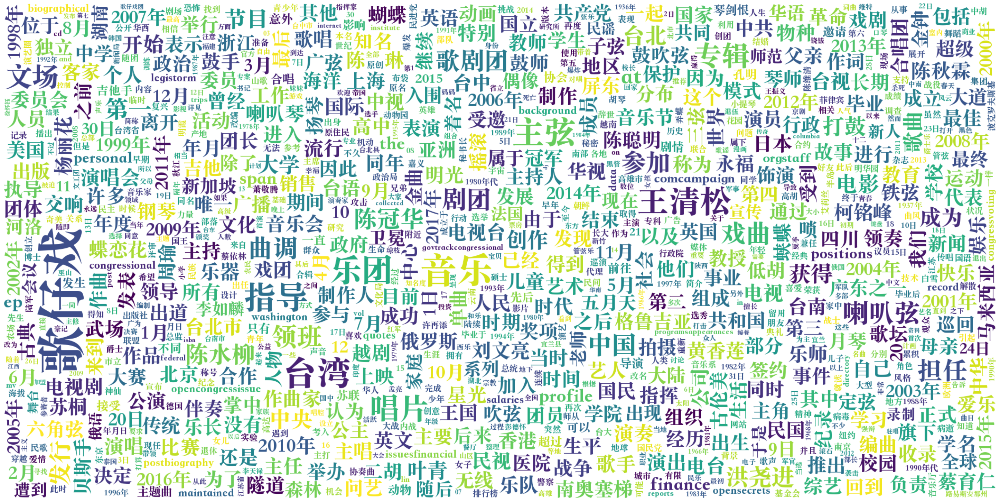

In [32]:
tm.plot_wordcloud(topic_id=5, topK=1000, output_path='../data/task4/topic_5.jpg', wordcloud_args=wordcloud_args, figsize=(40, 80))